In [1]:
from neural_analysis_pkg.core import NeuralAnalysis
import brpylib #import blackrock library

In [2]:
# Define the path to your project folder
project_folder_path ='/home/cresp1el-local/Documents/MATLAB/Data/lmc_project_v2/Whisker/'
# Initialize the NeuralAnalysis class with the project folder path
analysis = NeuralAnalysis(project_folder_path)
base_dir = '/home/cresp1el-local/smb/HochgeschwenderEphysandBehavior/'
analysis.extract_stimulation_data()

Loaded existing recording results dataframe from /home/cresp1el-local/Documents/MATLAB/Data/lmc_project_v2/Whisker/SpikeStuff/recording_results.csv


In [3]:
analysis.recording_results_df

,Unnamed: 0,group_name,recording_name,downsampled_path,rms_values,iqr,good_channels,noisy_channels,mua_data_path
0,0,Lmc_opsin,lmc_ch_2_3093_rec1,/home/cresp1el-local/Documents/MATLAB/Data/lmc...,"[170.52816270803297, 172.8074476873955, 175.11...",4.686566,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14,...",[13],/home/cresp1el-local/Documents/MATLAB/Data/lmc...
1,1,Lmc_opsin,lmc_ch_1_3094_rec2,/home/cresp1el-local/Documents/MATLAB/Data/lmc...,"[169.76160010287387, 172.07686648663235, 174.7...",3.035201,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",[31],/home/cresp1el-local/Documents/MATLAB/Data/lmc...
2,2,Lmc_opsin,lmc_ch_1_3094_rec1,/home/cresp1el-local/Documents/MATLAB/Data/lmc...,"[174.26712509310488, 172.37445379634585, 180.8...",7.463998,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",[],/home/cresp1el-local/Documents/MATLAB/Data/lmc...
3,3,Lmc_noopsin,lmc_noch_1_3096_rec1,/home/cresp1el-local/Documents/MATLAB/Data/lmc...,"[169.26424775999243, 171.4846387576975, 173.33...",2.762267,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",[31],/home/cresp1el-local/Documents/MATLAB/Data/lmc...
4,4,Lmc_noopsin,lmc_noch_1_3096_rec2,/home/cresp1el-local/Documents/MATLAB/Data/lmc...,"[170.05101760301815, 172.9588068684812, 170.34...",3.586824,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",[31],/home/cresp1el-local/Documents/MATLAB/Data/lmc...


In [4]:
analysis.process_ns6_files(project_folder_path, target_channel=35) # 35 is the channel with the whisker analog signal


lmc_ch_2_3093_whisker.ns6 opened

lmc_ch_2_3093_whisker.ns6 closed

lmc_ch_1_3094_whisker2.ns6 opened

lmc_ch_1_3094_whisker2.ns6 closed

lmc_ch_1_3094_whisker.ns6 opened

lmc_ch_1_3094_whisker.ns6 closed

lmc_noch_1_3096_whisker.ns6 opened

lmc_noch_1_3096_whisker.ns6 closed

lmc_noch_1_3096_whisker2.ns6 opened

lmc_noch_1_3096_whisker2.ns6 closed


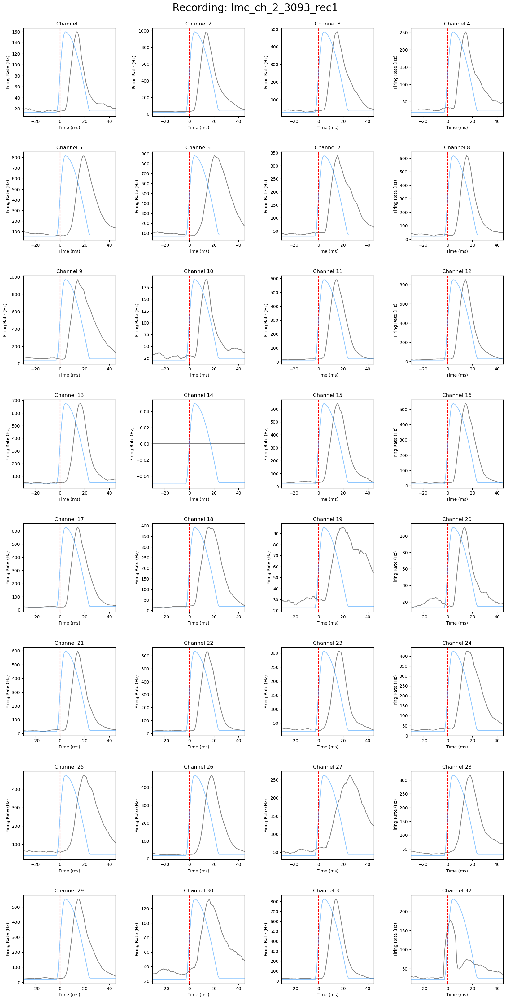

In [22]:
estimated_firing_rates = analysis.estimate_instantaneous_firing_rate_for_specific_recording('lmc_ch_2_3093_rec1', smooth=True, window_length = 0.01)
analysis.calculate_psth_and_plot_with_analog_signal('lmc_ch_2_3093_rec1', estimated_firing_rates, stim_id=2, zoom_in=True, zoom_in_window= [-30, 45])

lmc_ch_2_3093_rec1
Figure saved at /home/cresp1el-local/smb/HochgeschwenderEphysandBehavior/whisker_psths_prevspost/lmc_ch_2_3093_rec1_psth_prevspost.svg
lmc_ch_1_3094_rec2
Figure saved at /home/cresp1el-local/smb/HochgeschwenderEphysandBehavior/whisker_psths_prevspost/lmc_ch_1_3094_rec2_psth_prevspost.svg
lmc_ch_1_3094_rec1
Figure saved at /home/cresp1el-local/smb/HochgeschwenderEphysandBehavior/whisker_psths_prevspost/lmc_ch_1_3094_rec1_psth_prevspost.svg


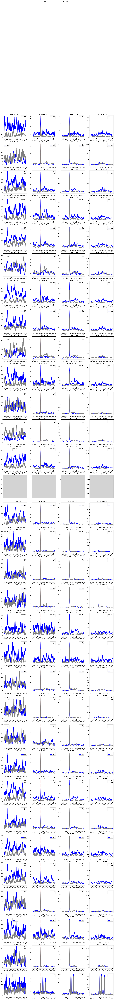

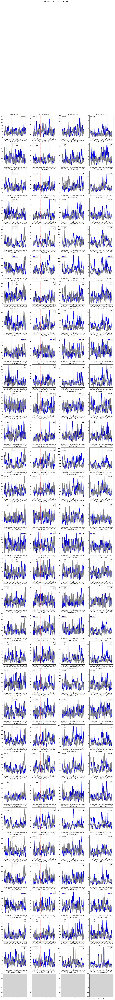

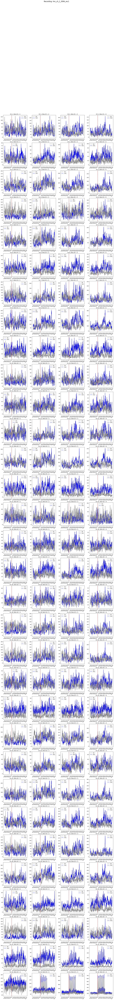

In [13]:
#create a dictionary to store the processed psths in the dictionary
processed_psths_dict = {}

#create a for loop to loop over each unique recording name in the recording_results_df
for recording_name in analysis.recording_results_df['recording_name'].unique():
    #print the recording name
    print(recording_name) 
    #calculate the firing rate estimates for the recording name
    firing_rates = analysis.estimate_instantaneous_firing_rate_for_specific_recording(recording_name, window_length=0.01, smooth=True)
    processed_psths_dict_tosave = analysis.calculate_psth_pre_post_and_plot_allgoodchannels(recording_name, firing_rates, base_dir=base_dir, pre_trials=30, post_trials=30)
    #store the processed psths in the dictionary, but remove the first key which is the name of the recording
    processed_psths_dict[recording_name] = processed_psths_dict_tosave[recording_name] 
        

In [14]:
import pandas as pd
import numpy as np

# Modify the process_psth_data function to handle the new dictionary structure that includes stimulus IDs
def process_psth_data_v2(data, recording_results_df ,early_window=(500, 550), late_window=(600, 1000)):
    # Initialize an empty list to store the rows for our DataFrame
    rows = []
    
    # Unpack the early and late window start and end times
    early_start, early_end = early_window
    late_start, late_end = late_window
    
    # Loop through each recording in the data
    for recording_name, channels in data.items():
        # Retrieve the noisy electrodes for this recording from recording_results_df
        noisy_electrodes = recording_results_df.loc[recording_results_df['recording_name'] == recording_name, 'noisy_channels'].values[0]
        # Convert 0-based noisy electrodes to the 'Ch_X' format
        noisy_channels = [f'Ch_{e+1}' for e in noisy_electrodes]
        
        # Loop through each channel in the recording
        for ch_name, channel_data in channels.items():
            # Determine if this channel is noisy
            is_noise = ch_name in noisy_channels
            
            # Loop through each stimulus ID in the channel
            for stim_id, psth_data in channel_data['Stim_IDs'].items():
                # Skip the iteration if data is 'N/A' (Noisy channels)
                if psth_data['pre-luciferin_mean_psth'] == 'N/A' or psth_data['post-luciferin_mean_psth'] == 'N/A':
                    continue
                
                # Extract the pre- and post-luciferin mean PSTHs
                pre_data = psth_data['pre-luciferin_mean_psth']
                post_data = psth_data['post-luciferin_mean_psth']
                
                # Calculate the mean and SD for the early window for both pre- and post-luciferin data
                pre_early_mean = np.mean(pre_data[early_start:early_end])
                pre_early_sd = np.std(pre_data[early_start:early_end])
                post_early_mean = np.mean(post_data[early_start:early_end])
                post_early_sd = np.std(post_data[early_start:early_end])
                
                # Calculate the mean and SD for the late window for both pre- and post-luciferin data
                pre_late_mean = np.mean(pre_data[late_start:late_end])
                pre_late_sd = np.std(pre_data[late_start:late_end])
                post_late_mean = np.mean(post_data[late_start:late_end])
                post_late_sd = np.std(post_data[late_start:late_end])
                
                # Check if the post-luciferin mean is greater than the pre-luciferin mean for the late window
                is_greater = post_late_mean > pre_late_mean
                
                # Calculate the 99% confidence intervals for the late windows
                ci_late_pre = 2.576 * (pre_late_sd / np.sqrt(pre_late_mean))
                ci_late_post = 2.576 * (post_late_sd / np.sqrt(post_late_mean))
                
                # Calculate the 99% confidence intervals for the early windows
                ci_early_pre = 2.576 * (pre_early_sd / np.sqrt(pre_early_mean))
                ci_early_post = 2.576 * (post_early_sd / np.sqrt(post_early_mean))
                
                # Check if the confidence interval for the post epoch is entirely above that for the pre epoch
                is_greater_late = (post_late_mean - ci_late_post) > (pre_late_mean + ci_late_pre)
                
                is_greater_early = (post_early_mean - ci_early_post) > (pre_early_mean + ci_early_pre)
                
                is_greater_both_phases = is_greater_early and is_greater_late
                
                # Append this information to our rows
                rows.append({
                    'Recording Name': recording_name,
                    'Channel ID': ch_name,
                    'Stimulus ID': stim_id,
                    'Pre Early Mean': pre_early_mean,
                    'Pre Early SD': pre_early_sd,
                    'Post Early Mean': post_early_mean,
                    'Post Early SD': post_early_sd,
                    'Pre Late Mean': pre_late_mean,
                    'Pre Late SD': pre_late_sd,
                    'Post Late Mean': post_late_mean,
                    'Post Late SD': post_late_sd,
                    'Late Phase Post > Pre': is_greater,
                    'Late Pre 99% CI': ci_late_pre,
                    'Late Post 99% CI': ci_late_post,
                    'Early Pre 99% CI': ci_early_pre,
                    'Early Post 99% CI': ci_early_post,
                    'Post > Pre (99% CI) Late': is_greater_late,
                    'Post > Pre (99% CI) Early': is_greater_early, 
                    'Post > Pre Both Phases (99% CI)': is_greater_both_phases,
                    'Is Noise': is_noise
                })
    
    # Create a DataFrame from the rows
    df = pd.DataFrame(rows)
    
    return df

output_df = process_psth_data_v2(processed_psths_dict, analysis.recording_results_df,  early_window=(500, 550), late_window=(700, 1300))

/tmp/ipykernel_378962/1944932077.py:28: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if psth_data['pre-luciferin_mean_psth'] == 'N/A' or psth_data['post-luciferin_mean_psth'] == 'N/A':


In [15]:
def extract_true_channels_with_stim(df, column_name='Post > Pre Both Phases (99% CI)'):
    true_channel_dict = {}
    
    for rec in df['Recording Name'].unique():
        df_rec = df[df['Recording Name'] == rec]
        true_channel_dict[rec] = {}
        
        for stim in df['Stimulus ID'].unique():
            df_stim = df_rec[df_rec['Stimulus ID'] == stim]
            true_channels = df_stim[df_stim[column_name] == True]['Channel ID'].tolist()
            
            true_channel_dict[rec][stim] = true_channels
            
    return true_channel_dict

# Example usage
# true_channels_dict = extract_true_channels_with_stim(output_df, column_name='Post > Pre Both Phases (99% CI)')
true_channels_dict = extract_true_channels_with_stim(output_df, column_name='Post > Pre (99% CI) Early') 

Plot the average for each 

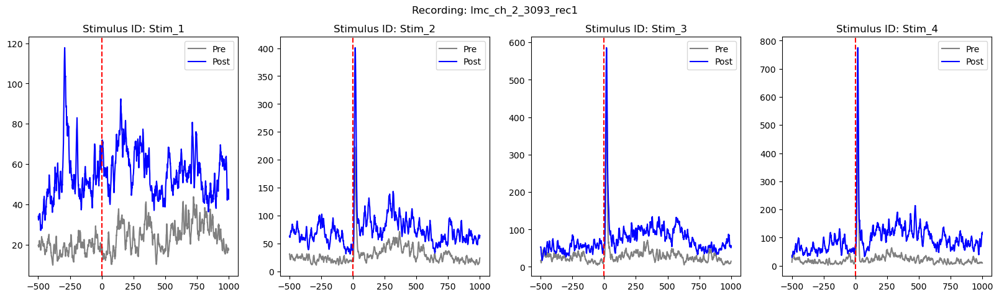

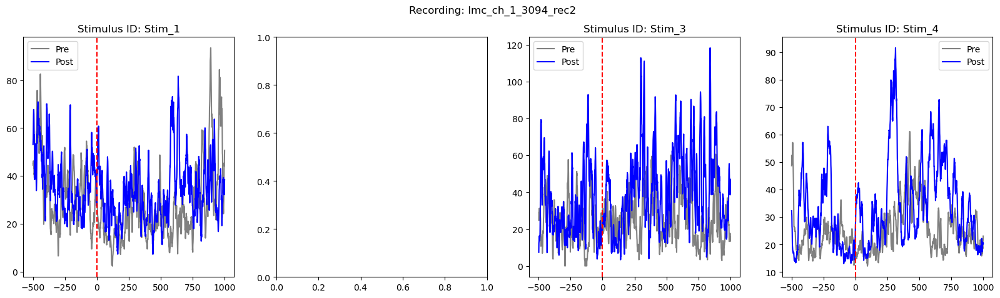

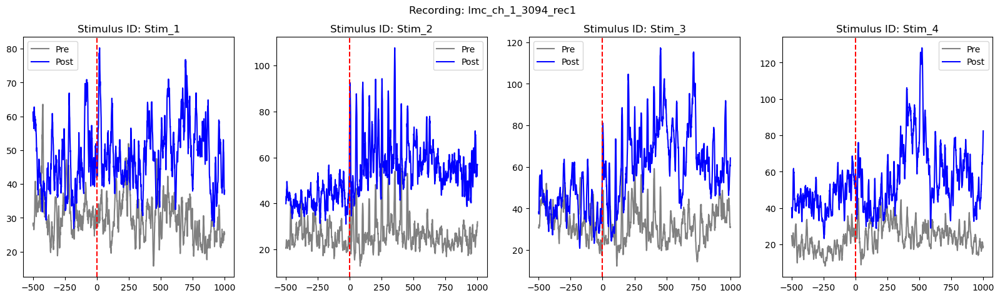

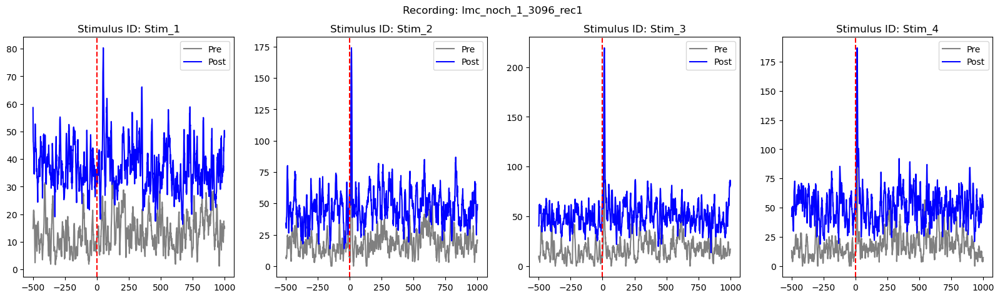

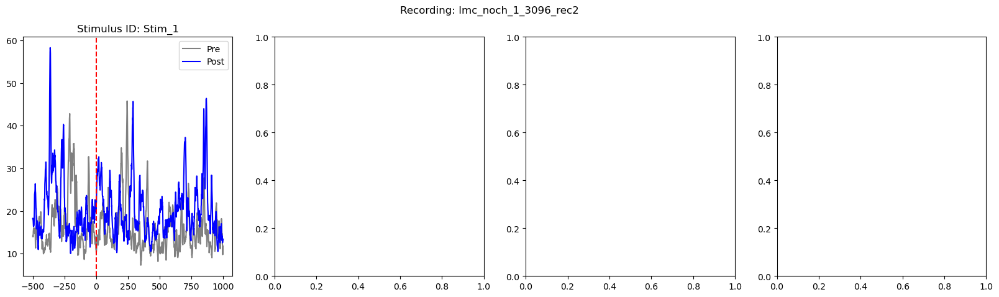

In [7]:
import matplotlib.pyplot as plt
def plot_average_psth(processed_psths_dict, true_channels_dict):
    """
    Plot the average PSTHs of channels that are considered "True" for each stimulus ID.
    
    Parameters:
    - processed_psths_dict: Nested dictionary containing the mean PSTHs for both pre and post periods for each channel and stimulus ID.
    - true_channels_dict: Nested dictionary containing the channels that are considered "True" for each stimulus ID.
    
    """
    # Initialize an empty dictionary to store all pre and post PSTHs for averaging later
    all_pre_psths = {}
    all_post_psths = {}
    
    # Iterate over each recording in the processed_psths_dict
    for recording_name, channel_data in processed_psths_dict.items():
        # Initialize lists to store all pre and post PSTHs for this recording
        all_pre_psths[recording_name] = {}
        all_post_psths[recording_name] = {}
        
        # Check if the recording name exists in the true_channels_dict
        if recording_name in true_channels_dict:
            # Iterate over each stimulus ID
            for stim_id in true_channels_dict[recording_name]:
                # Initialize lists to store all pre and post PSTHs for this stimulus ID
                all_pre_psths[recording_name][stim_id] = []
                all_post_psths[recording_name][stim_id] = []
                
                # Get the list of channels that are considered "True" for this stimulus ID
                true_channels = true_channels_dict[recording_name][stim_id]
                
                # Iterate over each "True" channel
                for channel in true_channels:
                    try:
                        # Get the pre and post PSTHs for this channel and stimulus ID
                        pre_psth = channel_data[channel]['Stim_IDs'][stim_id]['pre-luciferin_mean_psth']
                        post_psth = channel_data[channel]['Stim_IDs'][stim_id]['post-luciferin_mean_psth']
                        
                        # Append to the list of all pre and post PSTHs for this stimulus ID
                        all_pre_psths[recording_name][stim_id].append(pre_psth)
                        all_post_psths[recording_name][stim_id].append(post_psth)
                    except KeyError:
                        print(f"Channel {stim_id} not found in {recording_name}")
                        
    # Create a 1x4 grid of subplots for each recording
    for recording_name in all_pre_psths:
        fig, axs = plt.subplots(1, 4, figsize=(20, 5))
        fig.suptitle(f"Recording: {recording_name}")
        
        # Iterate over each stimulus ID (assuming 4 stimulus IDs: 'Stim_1', 'Stim_2', 'Stim_3', 'Stim_4')
        for idx, stim_id in enumerate(['Stim_1', 'Stim_2', 'Stim_3', 'Stim_4']):
            ax = axs[idx]
            
            # Check if there are any pre and post PSTHs for this stimulus ID
            if stim_id in all_pre_psths[recording_name] and all_pre_psths[recording_name][stim_id]:
                # Calculate the mean pre and post PSTHs
                mean_pre_psth = np.mean(np.array(all_pre_psths[recording_name][stim_id]), axis=0)
                mean_post_psth = np.mean(np.array(all_post_psths[recording_name][stim_id]), axis=0)
                
                # Plotting
                time_axis = np.arange(-499, 1001)  # Assuming time bins from -499 to 1000 ms
                ax.plot(time_axis, mean_pre_psth, label='Pre', color='grey')
                ax.plot(time_axis, mean_post_psth, label='Post', color='blue')
                ax.axvline(x=0, color='red', linestyle='--')
                ax.set_title(f"Stimulus ID: {stim_id}")
                ax.legend()
    
    plt.show()
    
# run the function
plot_average_psth(processed_psths_dict, true_channels_dict) 

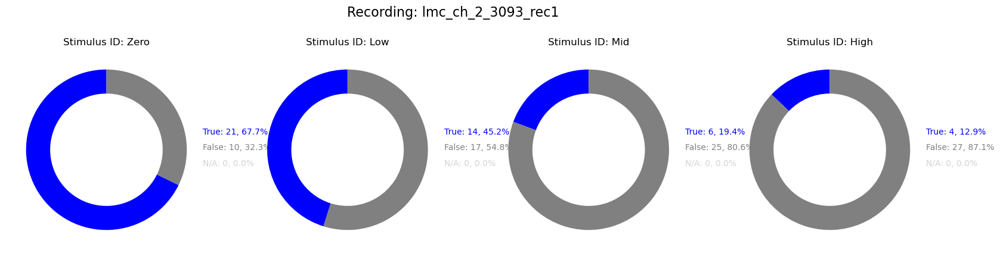

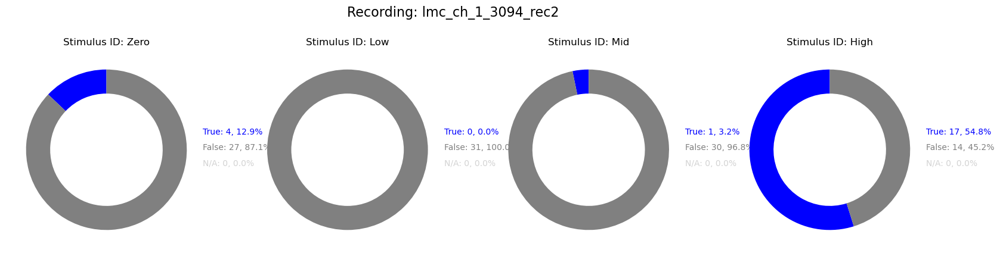

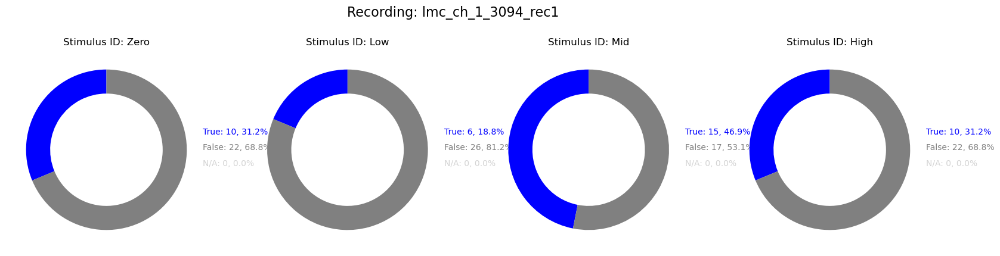

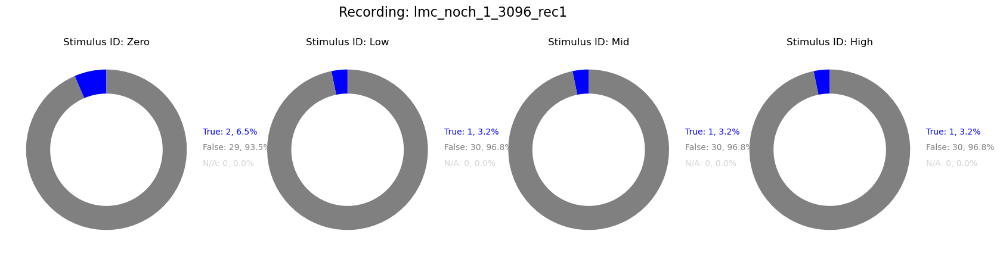

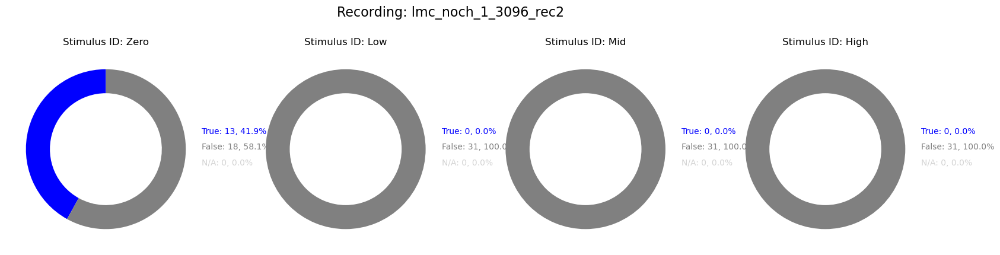

In [8]:
# Modified function to plot the proportion of channels where 'Post > Pre' is True for each unique recording and stimulus ID
# Now considers a "Noise" column in the DataFrame to filter out noise channels
def plot_proportions_v7(df, column_name_to_plot='Post > Pre (99% CI) Late'):
    unique_recordings = df['Recording Name'].unique()
    stim_id_mapping = {'Stim_1': 'Zero', 'Stim_2': 'Low', 'Stim_3': 'Mid', 'Stim_4': 'High'}
    
    for rec in unique_recordings:
        # Filter DataFrame to only include rows with the current recording name
        df_rec = df[df['Recording Name'] == rec]
        
        # Create a 1x4 subplot for each unique recording
        fig, axs = plt.subplots(1, 4, figsize=(20, 5))
        fig.suptitle(f'Recording: {rec}', fontsize=16)
        
        # Calculate the number of noisy channels for this recording
        noisy_channels = len(df_rec[df_rec['Is Noise'] == True]['Channel ID'].unique())
        
        for i, stim_id in enumerate(df['Stimulus ID'].unique()):
            # Filter DataFrame to only include rows with the current stimulus ID
            df_stim = df_rec[df_rec['Stimulus ID'] == stim_id]
            
            # Calculate the number of non-noisy channels for this stimulus ID
            total_channels = len(df_stim['Channel ID'].unique())
            
            # Calculate the proportion of channels where 'Post > Pre' is True, False, or N/A
            true_channels = len(df_stim[df_stim[column_name_to_plot] == True])
            false_channels = len(df_stim[df_stim[column_name_to_plot] == False])
            na_channels = noisy_channels  # Noisy channels are considered N/A
            
            # Calculate the percentages
            total = true_channels + false_channels + na_channels
            true_percentage = (true_channels / total) * 100 if total > 0 else 0
            false_percentage = (false_channels / total) * 100 if total > 0 else 0
            na_percentage = (na_channels / total) * 100 if total > 0 else 0
            
            # Create the pie chart
            wedges, texts, autotexts = axs[i].pie(
                [true_channels, false_channels, na_channels], 
                labels=[None]*3,  # Removed labels here
                colors=['blue', 'grey', 'lightgrey'], 
                autopct='',  # Removed default percentages
                startangle=90,
                wedgeprops=dict(width=0.3)
            )
            
            # Style for the autopct text (if needed)
            for autotext in autotexts:
                autotext.set_color('white')
            
            # Annotate the number of channels and percentages for each category
            axs[i].text(1.2, 0.2, f'True: {true_channels}, {true_percentage:.1f}%', color='blue')
            axs[i].text(1.2, 0, f'False: {false_channels}, {false_percentage:.1f}%', color='grey')
            axs[i].text(1.2, -0.2, f'N/A: {na_channels}, {na_percentage:.1f}%', color='lightgrey')
            
            axs[i].set_title(f'Stimulus ID: {stim_id_mapping[stim_id]}')

# Example usage
# Assuming df_with_noise_column is the DataFrame generated from process_psth_data_v4
# plot_proportions_v7(output_df, column_name_to_plot='Post > Pre Both Phases (99% CI)') #plot the proportion of channels where 'Post > Pre' is True for each unique recording and stimulus ID
plot_proportions_v7(output_df, column_name_to_plot='Post > Pre (99% CI) Early') #plot the proportion of channels where 'Post > Pre' is True for each unique recording and stimulus ID


PLOT THE AVERAGE AND SEM

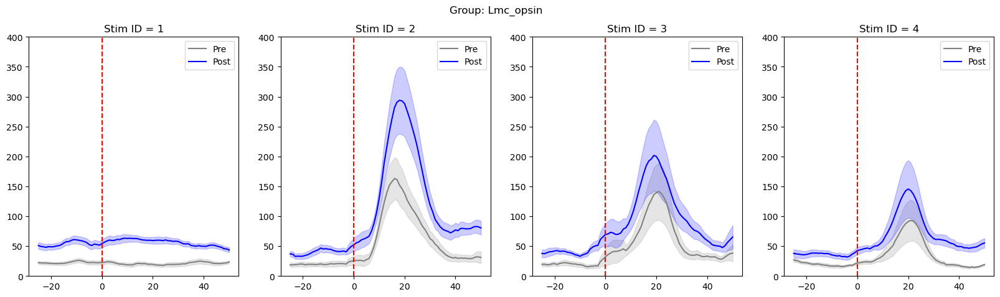

In [23]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_group_average_psth_with_sem(processed_psths_dict, true_channels_dict, recording_results_df, zoom_in=False, time_window=(-25, 50), y_range=None):
    
    start, end = time_window 
    
    # Create a dictionary to store group names and their respective recording names
    group_dict = {}
    for _, row in recording_results_df.iterrows():
        group_name = row['group_name']
        recording_name = row['recording_name']
        if group_name not in group_dict:
            group_dict[group_name] = []
        group_dict[group_name].append(recording_name)
        
    # Loop through each group
    for group_name, recording_names in group_dict.items():
        # Initialize a new figure for each group
        fig, axs = plt.subplots(1, 4, figsize=(20, 5))
        fig.suptitle(f'Group: {group_name}')
        
        # Loop through each Stimulus ID (1 to 4)
        for stim_id in range(1, 5):
            ax = axs[stim_id - 1]
            
            all_pre_psths = []
            all_post_psths = []
            
            # Loop through each recording in the group
            for recording_name in recording_names:
                # Loop through each channel that has a 'True' value in true_channels_dict
                for channel in true_channels_dict.get(recording_name, {}).get(f'Stim_{stim_id}', []):
                    
                    # Retrieve the pre and post PSTHs for this channel and stimulus
                    channel_data = processed_psths_dict.get(recording_name, {}).get(channel, {}).get('Stim_IDs', {}).get(f'Stim_{stim_id}', {})
                    pre_psth = channel_data.get('pre-luciferin_mean_psth', None)
                    post_psth = channel_data.get('post-luciferin_mean_psth', None)
                    
                    if pre_psth is not None:
                        all_pre_psths.append(pre_psth)
                    if post_psth is not None:
                        all_post_psths.append(post_psth)
            
            # Convert to NumPy arrays for easier manipulation
            all_pre_psths = np.array(all_pre_psths)
            all_post_psths = np.array(all_post_psths)
            
            # Calculate the mean and SEM for pre and post PSTHs
            mean_pre_psth = np.mean(all_pre_psths, axis=0)
            mean_post_psth = np.mean(all_post_psths, axis=0)
            sem_pre_psth = np.std(all_pre_psths, axis=0) / np.sqrt(all_pre_psths.shape[0])
            sem_post_psth = np.std(all_post_psths, axis=0) / np.sqrt(all_post_psths.shape[0])
            
            # Plotting
            time_axis = np.arange(-499, 1001)  # Assuming time bins from -499 to 1000 ms
            
            # Zoom-in logic
            if zoom_in:
                zoom_idx = np.where((time_axis >= start) & (time_axis <= end))
                time_axis = time_axis[zoom_idx]
                mean_pre_psth = mean_pre_psth[zoom_idx]
                mean_post_psth = mean_post_psth[zoom_idx]
                sem_pre_psth = sem_pre_psth[zoom_idx]
                sem_post_psth = sem_post_psth[zoom_idx]
            
            ax.plot(time_axis, mean_pre_psth, label='Pre', color='grey')
            ax.fill_between(time_axis, mean_pre_psth - sem_pre_psth, mean_pre_psth + sem_pre_psth, color='grey', alpha=0.2)
            
            ax.plot(time_axis, mean_post_psth, label='Post', color='blue')
            ax.fill_between(time_axis, mean_post_psth - sem_post_psth, mean_post_psth + sem_post_psth, color='blue', alpha=0.2)
            
            # Set y-axis range if specified
            if y_range is not None:
                ax.set_ylim(y_range) ## Set y-axis limits for this specific subplot, for example passing y_range=(0, 100) will set the y-axis to range from 0 to 100.
            
            ax.axvline(x=0, color='red', linestyle='--')
            ax.set_title(f'Stim ID = {stim_id}')
            ax.legend()
            
    # Save the plot as an SVG file
    plt.savefig('/home/cresp1el-local/smb/HochgeschwenderEphysandBehavior/Plots_for_lmc_paper/pooled_psth_whisker_firstdeflection.svg', format='svg')

# Example usage (you should replace these with your actual data)
# processed_psths_dict = ...  # Your processed PSTHs data
# true_channels_dict = ...    # Your true channels data
# recording_results_df = ...  # Your DataFrame containing 'group_name' and 'recording_name'


# plot_group_average_psth_with_sem(processed_psths_dict, true_channels_dict, analysis.recording_results_df, zoom_in=False)
plot_group_average_psth_with_sem(processed_psths_dict, true_channels_dict, analysis.recording_results_df, zoom_in=True, y_range=(0, 400))


In [16]:
#remove all rows with group name 'Lmc_noopsin' from recording results dataframe
analysis.recording_results_df = analysis.recording_results_df[analysis.recording_results_df['group_name']!='Lmc_noopsin']
analysis.recording_results_df #show recording results dataframe

,Unnamed: 0,group_name,recording_name,downsampled_path,rms_values,iqr,good_channels,noisy_channels,mua_data_path
0,0,Lmc_opsin,lmc_ch_2_3093_rec1,/home/cresp1el-local/Documents/MATLAB/Data/lmc...,"[170.52816270803297, 172.8074476873955, 175.11...",4.686566,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14,...",[13],/home/cresp1el-local/Documents/MATLAB/Data/lmc...
1,1,Lmc_opsin,lmc_ch_1_3094_rec2,/home/cresp1el-local/Documents/MATLAB/Data/lmc...,"[169.76160010287387, 172.07686648663235, 174.7...",3.035201,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",[31],/home/cresp1el-local/Documents/MATLAB/Data/lmc...
2,2,Lmc_opsin,lmc_ch_1_3094_rec1,/home/cresp1el-local/Documents/MATLAB/Data/lmc...,"[174.26712509310488, 172.37445379634585, 180.8...",7.463998,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",[],/home/cresp1el-local/Documents/MATLAB/Data/lmc...


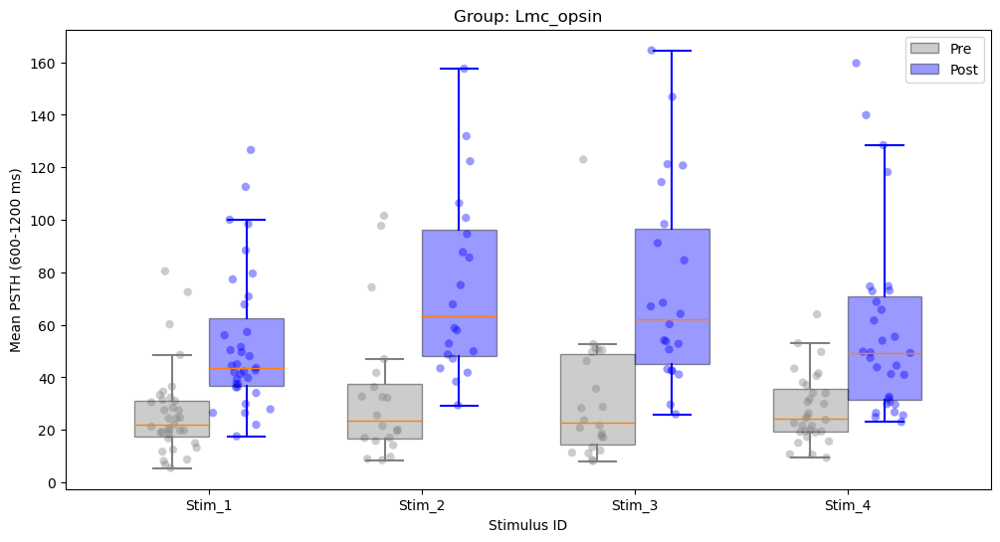

In [48]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

def plot_mean_sem_across_stimuli(processed_psths_dict, true_channels_dict, recording_results_df):
    group_dict = {}
    for _, row in recording_results_df.iterrows():
        group_name = row['group_name']
        recording_name = row['recording_name']
        if group_name not in group_dict:
            group_dict[group_name] = []
        group_dict[group_name].append(recording_name)
        
    stim_ids = list(range(1, 5))
    bar_width = 0.35
    jitter = 0.05  # amount of jitter for individual data points

    for group_name, recording_names in group_dict.items():
        all_pre_psths = []
        all_post_psths = []
        positions_pre = np.arange(len(stim_ids))
        positions_post = [x + bar_width for x in positions_pre]
        
        fig, ax = plt.subplots(figsize=(12, 6))
        plt.title(f'Group: {group_name}')
        
        for stim_id in stim_ids:
            all_pre_psths.append([])
            all_post_psths.append([])
            for recording_name in recording_names:
                for channel in true_channels_dict.get(recording_name, {}).get(f'Stim_{stim_id}', []):
                    channel_data = processed_psths_dict.get(recording_name, {}).get(channel, {}).get('Stim_IDs', {}).get(f'Stim_{stim_id}', {})
                    pre_psth = channel_data.get('pre-luciferin_mean_psth', None)
                    post_psth = channel_data.get('post-luciferin_mean_psth', None)
                    if pre_psth is not None:
                        all_pre_psths[-1].append(np.mean(pre_psth[600:1201]))
                    if post_psth is not None:
                        all_post_psths[-1].append(np.mean(post_psth[600:1201]))

        # Create invisible flierprops for 'Pre' and 'Post'
        invisible_flierprops = dict(alpha=0.0)
        
        # Create box plots for 'Pre' and set color
        bp_pre = ax.boxplot(all_pre_psths, positions=positions_pre, widths=bar_width, patch_artist=True, boxprops=dict(facecolor='grey', alpha=0.4), flierprops=invisible_flierprops)
        for whisker in bp_pre['whiskers']:
            whisker.set(color='grey', linewidth=1.5)
        for cap in bp_pre['caps']:
            cap.set(color='grey', linewidth=1.5)

        # Create box plots for 'Post' and set color
        bp_post = ax.boxplot(all_post_psths, positions=positions_post, widths=bar_width, patch_artist=True, boxprops=dict(facecolor='blue', alpha=0.4), flierprops=invisible_flierprops)
        for whisker in bp_post['whiskers']:
            whisker.set(color='blue', linewidth=1.5)
        for cap in bp_post['caps']:
            cap.set(color='blue', linewidth=1.5)
            
        # Scatter plots with jitter (as before)
        for i, data in enumerate(all_pre_psths):
            y = data
            x = np.random.normal(positions_pre[i], jitter, len(data))
            plt.scatter(x, y, c='grey', alpha=0.4, edgecolors='none')

        for i, data in enumerate(all_post_psths):
            y = data
            x = np.random.normal(positions_post[i], jitter, len(data))
            plt.scatter(x, y, c='blue', alpha=0.4, edgecolors='none')
        
        plt.xlabel('Stimulus ID')
        plt.ylabel('Mean PSTH (600-1200 ms)')
        plt.xticks([pos + bar_width / 2 for pos in positions_pre], [f'Stim_{i}' for i in stim_ids])
        plt.legend([bp_pre["boxes"][0], bp_post["boxes"][0]], ['Pre', 'Post'], loc='upper right')
        
        # Save the plot as an SVG file
        plt.savefig('/home/cresp1el-local/smb/HochgeschwenderEphysandBehavior/Plots_for_lmc_paper/pooled_psth_whisker_latephase_boxplots_600-1200ms.svg', format='svg')
        
        plt.show()

# Example usage:
# Replace these with your actual data
# processed_psths_dict, true_channels_dict, and recording_results_df should be your actual data
plot_mean_sem_across_stimuli(processed_psths_dict, true_channels_dict, analysis.recording_results_df)


In [49]:

import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import wilcoxon

# Helper function to calculate and print stats
def calculate_and_print_stats(data, label):
    mean_val = np.mean(data)
    sd_val = np.std(data)
    range_val = (np.min(data), np.max(data))
    median_val = np.median(data)
    print(f"{label}:")
    print(f"Mean: {mean_val}, SD: {sd_val}, Range: {range_val}, Median: {median_val}")

def run_statistical_tests(pre_data, post_data):
    p_values = [wilcoxon(pre, post).pvalue for pre, post in zip(pre_data, post_data)]
    corrected_p_values = [p * len(p_values) for p in p_values]  # Bonferroni correction
    reject = [p < 0.05 for p in corrected_p_values]
    return reject, corrected_p_values

def plot_mean_sem_across_stimuli_with_stats(processed_psths_dict, true_channels_dict, recording_results_df):
    group_dict = {}
    for _, row in recording_results_df.iterrows():
        group_name = row['group_name']
        recording_name = row['recording_name']
        if group_name not in group_dict:
            group_dict[group_name] = []
        group_dict[group_name].append(recording_name)
    
    stim_ids = list(range(1, 5))  # Assuming 4 stimulus IDs
    
    
    for group_name, recording_names in group_dict.items():
        
        all_pre_psths = []
        all_post_psths = []
        
        for stim_id in stim_ids:
            pre_psths = []
            post_psths = []
            for recording_name in recording_names:
                for channel in true_channels_dict.get(recording_name, {}).get(f'Stim_{stim_id}', []):
                    channel_data = processed_psths_dict.get(recording_name, {}).get(channel, {}).get('Stim_IDs', {}).get(f'Stim_{stim_id}', {})
                    pre_psth = channel_data.get('pre-luciferin_mean_psth', None)
                    post_psth = channel_data.get('post-luciferin_mean_psth', None)
                    if pre_psth is not None:
                        pre_psths.append(np.mean(pre_psth[600:1201]))  # Time window 600-1200 ms
                    if post_psth is not None:
                        post_psths.append(np.mean(post_psth[600:1201]))  # Time window 600-1200 ms
            
            all_pre_psths.append(pre_psths)
            all_post_psths.append(post_psths)
        
        # Run statistical tests
        reject, corrected_p_values = run_statistical_tests(all_pre_psths, all_post_psths)
        
        # Print statistics
        for i, (pre, post, rej, p_val) in enumerate(zip(all_pre_psths, all_post_psths, reject, corrected_p_values)):
            print(f"Statistics for Stim_{stim_ids[i]}:")
            calculate_and_print_stats(pre, 'Pre')
            calculate_and_print_stats(post, 'Post')
            print(f"Wilcoxon signed rank test (Bonferroni corrected): p = {p_val}, {'Rejected' if rej else 'Not Rejected'}")
            
# run the function
plot_mean_sem_across_stimuli_with_stats(processed_psths_dict, true_channels_dict, analysis.recording_results_df)


Statistics for Stim_1:
Pre:
Mean: 26.438252423853445, SD: 16.61761134101522, Range: (5.448371856814929, 80.40217878944479), Median: 22.052408332352808
Post:
Mean: 52.72583588446957, SD: 25.999816723766365, Range: (17.535465270760987, 126.59140596427693), Median: 43.585695919274166
Wilcoxon signed rank test (Bonferroni corrected): p = 2.3283064365386963e-10, Rejected
Statistics for Stim_2:
Pre:
Mean: 33.662760136937635, SD: 26.73391183184293, Range: (8.450115653196521, 101.56820549700004), Median: 23.487493876494327
Post:
Mean: 74.87303516196022, SD: 34.13831955144796, Range: (29.32273277120458, 157.53272508165222), Median: 63.263873961526315
Wilcoxon signed rank test (Bonferroni corrected): p = 7.62939453125e-06, Rejected
Statistics for Stim_3:
Pre:
Mean: 31.796127498318846, SD: 25.169795988417818, Range: (8.058364715699982, 122.92955399851962), Median: 22.635262838246724
Post:
Mean: 74.42022691085607, SD: 37.540919597689324, Range: (25.919403787808953, 164.5444461530091), Median: 62.1

Now lets calculate and plot for only the first deflection

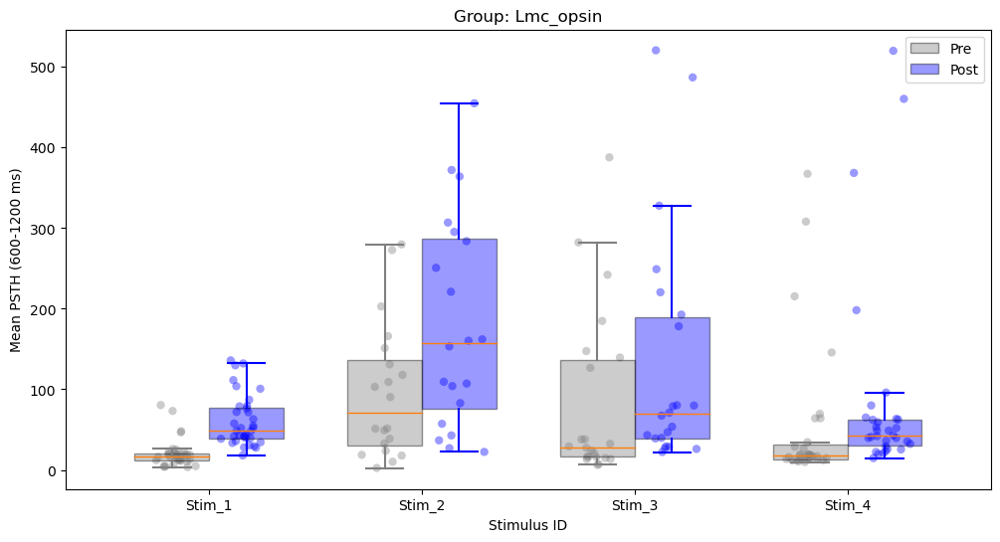

In [50]:
def plot_mean_sem_across_stimuli(processed_psths_dict, true_channels_dict, recording_results_df):
    group_dict = {}
    for _, row in recording_results_df.iterrows():
        group_name = row['group_name']
        recording_name = row['recording_name']
        if group_name not in group_dict:
            group_dict[group_name] = []
        group_dict[group_name].append(recording_name)
        
    stim_ids = list(range(1, 5))
    bar_width = 0.35
    jitter = 0.05  # amount of jitter for individual data points

    for group_name, recording_names in group_dict.items():
        all_pre_psths = []
        all_post_psths = []
        positions_pre = np.arange(len(stim_ids))
        positions_post = [x + bar_width for x in positions_pre]
        
        fig, ax = plt.subplots(figsize=(12, 6))
        plt.title(f'Group: {group_name}')
        
        for stim_id in stim_ids:
            all_pre_psths.append([])
            all_post_psths.append([])
            for recording_name in recording_names:
                for channel in true_channels_dict.get(recording_name, {}).get(f'Stim_{stim_id}', []):
                    channel_data = processed_psths_dict.get(recording_name, {}).get(channel, {}).get('Stim_IDs', {}).get(f'Stim_{stim_id}', {})
                    pre_psth = channel_data.get('pre-luciferin_mean_psth', None)
                    post_psth = channel_data.get('post-luciferin_mean_psth', None)
                    if pre_psth is not None:
                        all_pre_psths[-1].append(np.mean(pre_psth[500:525]))
                    if post_psth is not None:
                        all_post_psths[-1].append(np.mean(post_psth[500:525]))

        # Create invisible flierprops for 'Pre' and 'Post'
        invisible_flierprops = dict(alpha=0.0)
        
        # Create box plots for 'Pre' and set color
        bp_pre = ax.boxplot(all_pre_psths, positions=positions_pre, widths=bar_width, patch_artist=True, boxprops=dict(facecolor='grey', alpha=0.4), flierprops=invisible_flierprops)
        for whisker in bp_pre['whiskers']:
            whisker.set(color='grey', linewidth=1.5)
        for cap in bp_pre['caps']:
            cap.set(color='grey', linewidth=1.5)

        # Create box plots for 'Post' and set color
        bp_post = ax.boxplot(all_post_psths, positions=positions_post, widths=bar_width, patch_artist=True, boxprops=dict(facecolor='blue', alpha=0.4), flierprops=invisible_flierprops)
        for whisker in bp_post['whiskers']:
            whisker.set(color='blue', linewidth=1.5)
        for cap in bp_post['caps']:
            cap.set(color='blue', linewidth=1.5)
            
        # Scatter plots with jitter (as before)
        for i, data in enumerate(all_pre_psths):
            y = data
            x = np.random.normal(positions_pre[i], jitter, len(data))
            plt.scatter(x, y, c='grey', alpha=0.4, edgecolors='none')

        for i, data in enumerate(all_post_psths):
            y = data
            x = np.random.normal(positions_post[i], jitter, len(data))
            plt.scatter(x, y, c='blue', alpha=0.4, edgecolors='none')
        
        plt.xlabel('Stimulus ID')
        plt.ylabel('Mean PSTH (600-1200 ms)')
        plt.xticks([pos + bar_width / 2 for pos in positions_pre], [f'Stim_{i}' for i in stim_ids])
        plt.legend([bp_pre["boxes"][0], bp_post["boxes"][0]], ['Pre', 'Post'], loc='upper right')
        
        # Save the plot as an SVG file
        plt.savefig('/home/cresp1el-local/smb/HochgeschwenderEphysandBehavior/Plots_for_lmc_paper/pooled_psth_whisker_latephase_boxplots_500-525ms.svg', format='svg')
        
        plt.show()

# Example usage:
# Replace these with your actual data
# processed_psths_dict, true_channels_dict, and recording_results_df should be your actual data
plot_mean_sem_across_stimuli(processed_psths_dict, true_channels_dict, analysis.recording_results_df)

In [51]:
def plot_mean_sem_across_stimuli_with_stats(processed_psths_dict, true_channels_dict, recording_results_df):
    group_dict = {}
    for _, row in recording_results_df.iterrows():
        group_name = row['group_name']
        recording_name = row['recording_name']
        if group_name not in group_dict:
            group_dict[group_name] = []
        group_dict[group_name].append(recording_name)
    
    stim_ids = list(range(1, 5))  # Assuming 4 stimulus IDs
    
    
    for group_name, recording_names in group_dict.items():
        
        all_pre_psths = []
        all_post_psths = []
        
        for stim_id in stim_ids:
            pre_psths = []
            post_psths = []
            for recording_name in recording_names:
                for channel in true_channels_dict.get(recording_name, {}).get(f'Stim_{stim_id}', []):
                    channel_data = processed_psths_dict.get(recording_name, {}).get(channel, {}).get('Stim_IDs', {}).get(f'Stim_{stim_id}', {})
                    pre_psth = channel_data.get('pre-luciferin_mean_psth', None)
                    post_psth = channel_data.get('post-luciferin_mean_psth', None)
                    if pre_psth is not None:
                        pre_psths.append(np.mean(pre_psth[500:525]))  # Time window 600-1200 ms
                    if post_psth is not None:
                        post_psths.append(np.mean(post_psth[500:525]))  # Time window 600-1200 ms
            
            all_pre_psths.append(pre_psths)
            all_post_psths.append(post_psths)
        
        # Run statistical tests
        reject, corrected_p_values = run_statistical_tests(all_pre_psths, all_post_psths)
        
        # Print statistics
        for i, (pre, post, rej, p_val) in enumerate(zip(all_pre_psths, all_post_psths, reject, corrected_p_values)):
            print(f"Statistics for Stim_{stim_ids[i]}:")
            calculate_and_print_stats(pre, 'Pre')
            calculate_and_print_stats(post, 'Post')
            print(f"Wilcoxon signed rank test (Bonferroni corrected): p = {p_val}, {'Rejected' if rej else 'Not Rejected'}")
            
# run the function
plot_mean_sem_across_stimuli_with_stats(processed_psths_dict, true_channels_dict, analysis.recording_results_df)

Statistics for Stim_1:
Pre:
Mean: 20.26162779232225, SD: 16.917821541671344, Range: (3.5278573945809786, 80.48649472354306), Median: 17.34588300507421
Post:
Mean: 60.68404050997334, SD: 31.55897133429686, Range: (18.03457422699284, 135.88344368886837), Median: 48.68207182004363
Wilcoxon signed rank test (Bonferroni corrected): p = 2.3283064365386963e-10, Rejected
Statistics for Stim_2:
Pre:
Mean: 95.99692017892544, SD: 81.60484889232113, Range: (2.4501180501670583, 279.7848942459386), Median: 70.93712638188475
Post:
Mean: 180.6685663685985, SD: 126.97959017824107, Range: (22.390460741693182, 454.711174419753), Median: 156.77358916074863
Wilcoxon signed rank test (Bonferroni corrected): p = 7.62939453125e-06, Rejected
Statistics for Stim_3:
Pre:
Mean: 82.94421018366029, SD: 103.71027868850207, Range: (6.273147398744412, 387.67381230885775), Median: 28.366642839166435
Post:
Mean: 132.23042028834232, SD: 143.39535664041492, Range: (22.24628006909696, 520.4295491106063), Median: 69.2599038

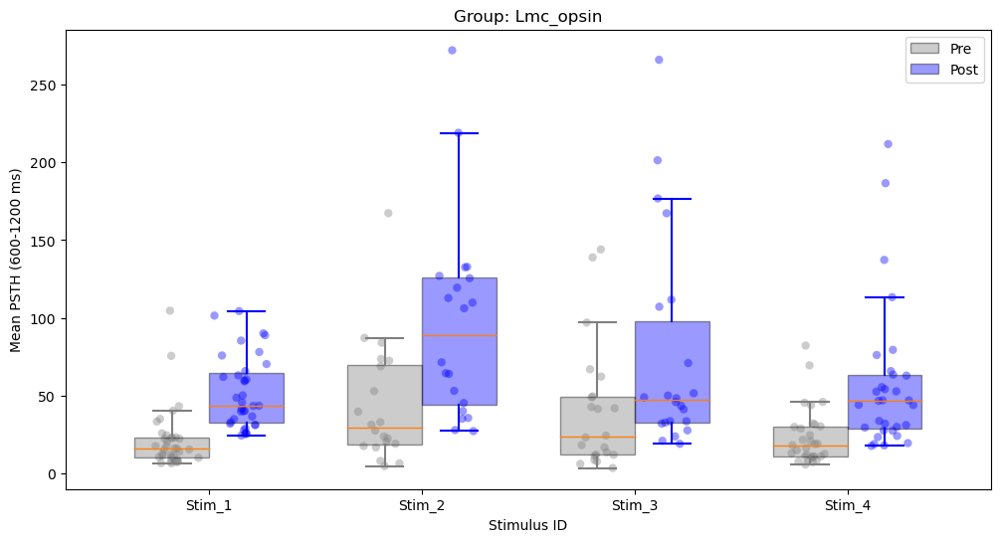

In [52]:
def plot_mean_sem_across_stimuli(processed_psths_dict, true_channels_dict, recording_results_df):
    group_dict = {}
    for _, row in recording_results_df.iterrows():
        group_name = row['group_name']
        recording_name = row['recording_name']
        if group_name not in group_dict:
            group_dict[group_name] = []
        group_dict[group_name].append(recording_name)
        
    stim_ids = list(range(1, 5))
    bar_width = 0.35
    jitter = 0.05  # amount of jitter for individual data points

    for group_name, recording_names in group_dict.items():
        all_pre_psths = []
        all_post_psths = []
        positions_pre = np.arange(len(stim_ids))
        positions_post = [x + bar_width for x in positions_pre]
        
        fig, ax = plt.subplots(figsize=(12, 6))
        plt.title(f'Group: {group_name}')
        
        for stim_id in stim_ids:
            all_pre_psths.append([])
            all_post_psths.append([])
            for recording_name in recording_names:
                for channel in true_channels_dict.get(recording_name, {}).get(f'Stim_{stim_id}', []):
                    channel_data = processed_psths_dict.get(recording_name, {}).get(channel, {}).get('Stim_IDs', {}).get(f'Stim_{stim_id}', {})
                    pre_psth = channel_data.get('pre-luciferin_mean_psth', None)
                    post_psth = channel_data.get('post-luciferin_mean_psth', None)
                    if pre_psth is not None:
                        all_pre_psths[-1].append(np.mean(pre_psth[525:550]))
                    if post_psth is not None:
                        all_post_psths[-1].append(np.mean(post_psth[525:550]))

        # Create invisible flierprops for 'Pre' and 'Post'
        invisible_flierprops = dict(alpha=0.0)
        
        # Create box plots for 'Pre' and set color
        bp_pre = ax.boxplot(all_pre_psths, positions=positions_pre, widths=bar_width, patch_artist=True, boxprops=dict(facecolor='grey', alpha=0.4), flierprops=invisible_flierprops)
        for whisker in bp_pre['whiskers']:
            whisker.set(color='grey', linewidth=1.5)
        for cap in bp_pre['caps']:
            cap.set(color='grey', linewidth=1.5)

        # Create box plots for 'Post' and set color
        bp_post = ax.boxplot(all_post_psths, positions=positions_post, widths=bar_width, patch_artist=True, boxprops=dict(facecolor='blue', alpha=0.4), flierprops=invisible_flierprops)
        for whisker in bp_post['whiskers']:
            whisker.set(color='blue', linewidth=1.5)
        for cap in bp_post['caps']:
            cap.set(color='blue', linewidth=1.5)
            
        # Scatter plots with jitter (as before)
        for i, data in enumerate(all_pre_psths):
            y = data
            x = np.random.normal(positions_pre[i], jitter, len(data))
            plt.scatter(x, y, c='grey', alpha=0.4, edgecolors='none')

        for i, data in enumerate(all_post_psths):
            y = data
            x = np.random.normal(positions_post[i], jitter, len(data))
            plt.scatter(x, y, c='blue', alpha=0.4, edgecolors='none')
        
        plt.xlabel('Stimulus ID')
        plt.ylabel('Mean PSTH (600-1200 ms)')
        plt.xticks([pos + bar_width / 2 for pos in positions_pre], [f'Stim_{i}' for i in stim_ids])
        plt.legend([bp_pre["boxes"][0], bp_post["boxes"][0]], ['Pre', 'Post'], loc='upper right')
        
        # Save the plot as an SVG file
        plt.savefig('/home/cresp1el-local/smb/HochgeschwenderEphysandBehavior/Plots_for_lmc_paper/pooled_psth_whisker_latephase_boxplots_525-550ms.svg', format='svg')
        
        plt.show()

# Example usage:
# Replace these with your actual data
# processed_psths_dict, true_channels_dict, and recording_results_df should be your actual data
plot_mean_sem_across_stimuli(processed_psths_dict, true_channels_dict, analysis.recording_results_df)

In [53]:
def plot_mean_sem_across_stimuli_with_stats(processed_psths_dict, true_channels_dict, recording_results_df):
    group_dict = {}
    for _, row in recording_results_df.iterrows():
        group_name = row['group_name']
        recording_name = row['recording_name']
        if group_name not in group_dict:
            group_dict[group_name] = []
        group_dict[group_name].append(recording_name)
    
    stim_ids = list(range(1, 5))  # Assuming 4 stimulus IDs
    
    
    for group_name, recording_names in group_dict.items():
        
        all_pre_psths = []
        all_post_psths = []
        
        for stim_id in stim_ids:
            pre_psths = []
            post_psths = []
            for recording_name in recording_names:
                for channel in true_channels_dict.get(recording_name, {}).get(f'Stim_{stim_id}', []):
                    channel_data = processed_psths_dict.get(recording_name, {}).get(channel, {}).get('Stim_IDs', {}).get(f'Stim_{stim_id}', {})
                    pre_psth = channel_data.get('pre-luciferin_mean_psth', None)
                    post_psth = channel_data.get('post-luciferin_mean_psth', None)
                    if pre_psth is not None:
                        pre_psths.append(np.mean(pre_psth[525:550]))  # Time window 600-1200 ms
                    if post_psth is not None:
                        post_psths.append(np.mean(post_psth[525:550]))  # Time window 600-1200 ms
            
            all_pre_psths.append(pre_psths)
            all_post_psths.append(post_psths)
        
        # Run statistical tests
        reject, corrected_p_values = run_statistical_tests(all_pre_psths, all_post_psths)
        
        # Print statistics
        for i, (pre, post, rej, p_val) in enumerate(zip(all_pre_psths, all_post_psths, reject, corrected_p_values)):
            print(f"Statistics for Stim_{stim_ids[i]}:")
            calculate_and_print_stats(pre, 'Pre')
            calculate_and_print_stats(post, 'Post')
            print(f"Wilcoxon signed rank test (Bonferroni corrected): p = {p_val}, {'Rejected' if rej else 'Not Rejected'}")
            
# run the function
plot_mean_sem_across_stimuli_with_stats(processed_psths_dict, true_channels_dict, analysis.recording_results_df)

Statistics for Stim_1:
Pre:
Mean: 21.773450038986383, SD: 19.526852746889926, Range: (6.571022512002057, 104.63299315255193), Median: 16.10335105201
Post:
Mean: 51.900472841884955, SD: 22.761411155491814, Range: (24.436862068827235, 104.38956445315172), Median: 43.55744094914018
Wilcoxon signed rank test (Bonferroni corrected): p = 4.656612873077393e-10, Rejected
Statistics for Stim_2:
Pre:
Mean: 43.92169872822059, SD: 38.297959324241916, Range: (4.802620914910822, 167.3272335635028), Median: 29.506543469584873
Post:
Mean: 96.10564602983021, SD: 62.677501130234546, Range: (27.302337159576236, 271.9943683267284), Median: 88.85576215069888
Wilcoxon signed rank test (Bonferroni corrected): p = 7.62939453125e-06, Rejected
Statistics for Stim_3:
Pre:
Mean: 40.57293212305385, SD: 39.504401075168616, Range: (3.568873797759469, 144.03153649213897), Median: 23.840682526325065
Post:
Mean: 75.23238325100812, SD: 66.44066345544377, Range: (19.138102962486744, 265.90110291582715), Median: 47.177209

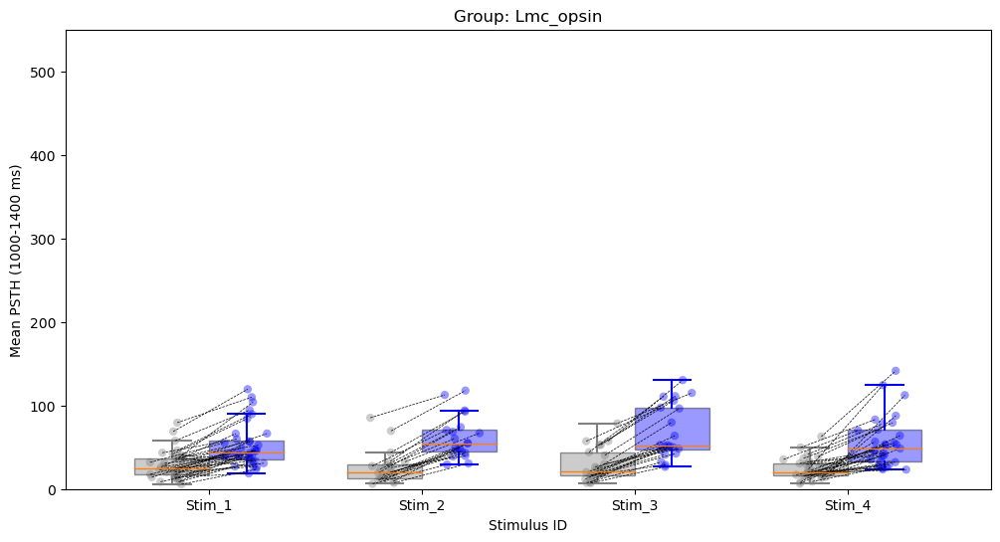

In [64]:
import numpy as np
import matplotlib.pyplot as plt

def plot_mean_sem_across_stimuli(processed_psths_dict, true_channels_dict, recording_results_df, time_window=(525, 550), y_range=None):

    start, end = time_window
    group_dict = {}
    for _, row in recording_results_df.iterrows():
        group_name = row['group_name']
        recording_name = row['recording_name']
        if group_name not in group_dict:
            group_dict[group_name] = []
        group_dict[group_name].append(recording_name)
        
    stim_ids = list(range(1, 5))
    bar_width = 0.35
    jitter = 0.05  # amount of jitter for individual data points

    for group_name, recording_names in group_dict.items():
        all_pre_psths = []
        all_post_psths = []
        positions_pre = np.arange(len(stim_ids))
        positions_post = [x + bar_width for x in positions_pre]
        
        fig, ax = plt.subplots(figsize=(12, 6))
        plt.title(f'Group: {group_name}')
        
        for stim_id in stim_ids:
            all_pre_psths.append([])
            all_post_psths.append([])
            for recording_name in recording_names:
                for channel in true_channels_dict.get(recording_name, {}).get(f'Stim_{stim_id}', []):
                    channel_data = processed_psths_dict.get(recording_name, {}).get(channel, {}).get('Stim_IDs', {}).get(f'Stim_{stim_id}', {})
                    pre_psth = channel_data.get('pre-luciferin_mean_psth', None)
                    post_psth = channel_data.get('post-luciferin_mean_psth', None)
                    if pre_psth is not None:
                        all_pre_psths[-1].append(np.mean(pre_psth[start:end]))
                    if post_psth is not None:
                        all_post_psths[-1].append(np.mean(post_psth[start:end]))

        # Add back the box plots
        bp_pre = ax.boxplot(all_pre_psths, positions=positions_pre, widths=bar_width, patch_artist=True, boxprops=dict(facecolor='grey', alpha=0.4), sym='')
        bp_post = ax.boxplot(all_post_psths, positions=positions_post, widths=bar_width, patch_artist=True, boxprops=dict(facecolor='blue', alpha=0.4), sym='')

        # Color code the error bars
        for whisker in bp_pre['whiskers']:
            whisker.set(color='grey', linewidth=1.5)
        for cap in bp_pre['caps']:
            cap.set(color='grey', linewidth=1.5)
        for whisker in bp_post['whiskers']:
            whisker.set(color='blue', linewidth=1.5)
        for cap in bp_post['caps']:
            cap.set(color='blue', linewidth=1.5)
        
        # Scatter plots with jitter
        for i, (data_pre, data_post) in enumerate(zip(all_pre_psths, all_post_psths)):
            # Same random jitter for both pre and post
            x_jitter = np.random.normal(0, jitter, len(data_pre))
            x_pre = positions_pre[i] + x_jitter
            x_post = positions_post[i] + x_jitter
            
            plt.scatter(x_pre, data_pre, c='grey', alpha=0.4, edgecolors='none')
            plt.scatter(x_post, data_post, c='blue', alpha=0.4, edgecolors='none')
            
            # Connecting lines
            for pre, post, x1, x2 in zip(data_pre, data_post, x_pre, x_post):
                plt.plot([x1, x2], [pre, post], linestyle='--', linewidth=0.5, color='black')

        plt.xlabel('Stimulus ID')
        plt.ylabel(f'Mean PSTH ({start}-{end} ms)')
        # Set y-axis range if specified
        if y_range is not None:
            plt.ylim(y_range) #For example, passing y_range=(0, 100) will set the y-axis to range from 0 to 100.
        
        plt.xticks([pos + bar_width / 2 for pos in positions_pre], [f'Stim_{i}' for i in stim_ids])        
        plt.savefig(f'/home/cresp1el-local/smb/HochgeschwenderEphysandBehavior/Plots_for_lmc_paper/pooled_psth_whisker_boxplots_{start}-{end}ms.svg', format='svg')

        plt.show()

# run the function
plot_mean_sem_across_stimuli(processed_psths_dict, true_channels_dict, analysis.recording_results_df, time_window=(1000, 1400), y_range=(0, 550))

In [66]:
def print_mean_sem_across_stimuli_with_stats(processed_psths_dict, true_channels_dict, recording_results_df, time_window=(525,550)):
    start, end = time_window
    group_dict = {}
    for _, row in recording_results_df.iterrows():
        group_name = row['group_name']
        recording_name = row['recording_name']
        if group_name not in group_dict:
            group_dict[group_name] = []
        group_dict[group_name].append(recording_name)
    
    stim_ids = list(range(1, 5))  # Assuming 4 stimulus IDs
    
    
    for group_name, recording_names in group_dict.items():
        
        all_pre_psths = []
        all_post_psths = []
        
        for stim_id in stim_ids:
            pre_psths = []
            post_psths = []
            for recording_name in recording_names:
                for channel in true_channels_dict.get(recording_name, {}).get(f'Stim_{stim_id}', []):
                    channel_data = processed_psths_dict.get(recording_name, {}).get(channel, {}).get('Stim_IDs', {}).get(f'Stim_{stim_id}', {})
                    pre_psth = channel_data.get('pre-luciferin_mean_psth', None)
                    post_psth = channel_data.get('post-luciferin_mean_psth', None)
                    if pre_psth is not None:
                        pre_psths.append(np.mean(pre_psth[start:end]))  # Time window 600-1200 ms
                    if post_psth is not None:
                        post_psths.append(np.mean(post_psth[start:end]))  # Time window 600-1200 ms
            
            all_pre_psths.append(pre_psths)
            all_post_psths.append(post_psths)
        
        # Run statistical tests
        reject, corrected_p_values = run_statistical_tests(all_pre_psths, all_post_psths)
        
        # Print statistics
        for i, (pre, post, rej, p_val) in enumerate(zip(all_pre_psths, all_post_psths, reject, corrected_p_values)):
            print(f"Statistics for Stim_{stim_ids[i]}:")
            calculate_and_print_stats(pre, 'Pre')
            calculate_and_print_stats(post, 'Post')
            print(f"Wilcoxon signed rank test (Bonferroni corrected): p = {p_val}, {'Rejected' if rej else 'Not Rejected'}")
            
# run the function
print_mean_sem_across_stimuli_with_stats(processed_psths_dict, true_channels_dict, analysis.recording_results_df, time_window=(525,550))

Statistics for Stim_1:
Pre:
Mean: 21.773450038986383, SD: 19.526852746889926, Range: (6.571022512002057, 104.63299315255193), Median: 16.10335105201
Post:
Mean: 51.900472841884955, SD: 22.761411155491814, Range: (24.436862068827235, 104.38956445315172), Median: 43.55744094914018
Wilcoxon signed rank test (Bonferroni corrected): p = 4.656612873077393e-10, Rejected
Statistics for Stim_2:
Pre:
Mean: 43.92169872822059, SD: 38.297959324241916, Range: (4.802620914910822, 167.3272335635028), Median: 29.506543469584873
Post:
Mean: 96.10564602983021, SD: 62.677501130234546, Range: (27.302337159576236, 271.9943683267284), Median: 88.85576215069888
Wilcoxon signed rank test (Bonferroni corrected): p = 7.62939453125e-06, Rejected
Statistics for Stim_3:
Pre:
Mean: 40.57293212305385, SD: 39.504401075168616, Range: (3.568873797759469, 144.03153649213897), Median: 23.840682526325065
Post:
Mean: 75.23238325100812, SD: 66.44066345544377, Range: (19.138102962486744, 265.90110291582715), Median: 47.177209

In [ ]:
analysis.process_ns6_files(project_folder_path, target_channel=33) # 33 is the channel number of the whisker data in the ns6 file

In [ ]:
estimated_firing_rates = analysis.estimate_instantaneous_firing_rate_for_specific_recording('lmc_ch_1_3094_rec2', smooth=True, window_length = 0.01)
analysis.calculate_psth_and_plot('lmc_ch_1_3094_rec2', estimated_firing_rates, stim_id=4, bin_size=0.001)

In [ ]:
analysis.calculate_psth_and_plot('lmc_ch_1_3094_rec1', estimated_firing_rates, stim_id=1, bin_size=0.001)
analysis.calculate_psth_and_plot('lmc_ch_1_3094_rec1', estimated_firing_rates, stim_id=2, bin_size=0.001)
analysis.calculate_psth_and_plot('lmc_ch_1_3094_rec1', estimated_firing_rates, stim_id=3, bin_size=0.001)
analysis.calculate_psth_and_plot('lmc_ch_1_3094_rec1', estimated_firing_rates, stim_id=4, bin_size=0.001)

In [ ]:
analysis.enhanced_spike_detection_and_filtering(md=2)

In [ ]:
test = analysis.estimate_instantaneous_firing_rate_for_confirmed_spikes_for_specific_recording('lmc_ch_1_3094_rec2', window_length=0.01, smooth=True) 

In [ ]:
analysis.calculate_psth_and_plot('lmc_ch_1_3094_rec1', test, stim_id=4, bin_size=0.001)

In [ ]:
analysis.calculate_psth_pre_post_and_plot_allgoodchannels('lmc_ch_2_3093_rec2', test, base_dir=base_dir, pre_trials=30, post_trials=30)

In [ ]:
test.shape

In [ ]:
analysis.enhanced_spike_detection_and_filtering(md=10)

In [ ]:
raw_firing_rates = analysis.estimate_instantaneous_firing_rate_for_specific_recording('lmc_ch_1_3094_rec1', window_length=0.01, smooth=True)
analysis.calculate_psth_pre_post_and_plot_allgoodchannels('lmc_ch_1_3094_rec1', raw_firing_rates, base_dir=base_dir, pre_trials=30, post_trials=30)

In [ ]:
# Define the path to your project folder
LEDproject_folder_path ='/home/cresp1el-local/Documents/MATLAB/Data/lmc_project_v2/LED'
# Initialize the NeuralAnalysis class with the project folder path
LEDanalysis = NeuralAnalysis(LEDproject_folder_path)
base_dir = '/home/cresp1el-local/smb/HochgeschwenderEphysandBehavior/'
LEDanalysis.extract_stimulation_data()

In [ ]:
#analysis.process_MUA() # Process the MUA data to create the downsampled and filtered MUA data, no need to do this again if you have already done it once

# save this dataframe to a csv file using the csv file path as the argument so you dont have to run the downsampling and filtering again
# analysis.recording_results_df.to_csv(os.path.join(project_folder_path,'SpikeStuff/recording_results.csv'))

In [ ]:
analysis.recording_results_df

In [ ]:
analysis.stimulation_data_df

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd 

def calculate_firing_rates(recording_name, recording_results_df, stimulation_data_df, n_channels):
    # Get the mua_data_path for the current recording to get the spike_data_path where the spike times are stored
    mua_data_path = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'mua_data_path'
    ].values[0]
    
    # Construct the spike_data_path from the mua_data_path
    spike_data_path = mua_data_path.replace('_MUA.npy', '_spike_times.npy')
    
    # Step 1: Identify the time windows for stimulus_id = 1
    stim_data = stimulation_data_df[
        (stimulation_data_df['recording_name'] == recording_name) & 
        (stimulation_data_df['stimulation_ids'] == 2)
    ]
    
    # Step 2: Load the corresponding spike times
    spike_data = np.load(spike_data_path, allow_pickle=True)
    spike_times = spike_data['time']
    spike_channels = spike_data['channel']
    
    # Get good and noisy channels for the current recording
    good_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'good_channels'
    ].values[0]
    noisy_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'noisy_channels'
    ].values[0]

    # Step 3 & 4: Calculate and aggregate the firing rates
    firing_rates = np.full((n_channels, len(stim_data)), np.nan) # Initialize with NaNs 

    for i, (onset, offset) in enumerate(zip(stim_data['onset_times'], stim_data['offset_times'])):
        for ch in good_channels:
            # Find spikes in the current channel and time window
            condition = (spike_channels == ch) & (spike_times >= onset) & (spike_times <= offset)
            spikes_in_window = spike_times[np.where(condition)]
            
            # Calculate the firing rate
            firing_rate = len(spikes_in_window) / (offset - onset)
            firing_rates[ch, i] = firing_rate
    
    # Step 5: Plotting the heatmap
    plt.imshow(firing_rates, aspect='auto', cmap='hot', interpolation='nearest')
    plt.colorbar(label='Firing Rate (Hz)')
    plt.ylabel('Channel')
    plt.xlabel('Trial')
    plt.title('Firing Rate Heatmap for Stimulus ID = 2')
    plt.yticks(range(n_channels), range(1, n_channels+1))  # Label y-axis with channel numbers
    plt.show()
    
#run the function
calculate_firing_rates('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels)


FOR STIM 2

In [ ]:
def calculate_firing_rates(recording_name, recording_results_df, stimulation_data_df, n_channels):
    # Get the mua_data_path for the current recording to get the spike_data_path where the spike times are stored
    mua_data_path = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'mua_data_path'
    ].values[0]
    
    # Construct the spike_data_path from the mua_data_path
    spike_data_path = mua_data_path.replace('_MUA.npy', '_spike_times.npy')
    
    # Step 1: Identify the time windows for stimulus_id = 2
    stim_data = stimulation_data_df[
        (stimulation_data_df['recording_name'] == recording_name) & 
        (stimulation_data_df['stimulation_ids'] == 2)
    ]
    
    # Step 2: Load the corresponding spike times
    spike_data = np.load(spike_data_path, allow_pickle=True)
    spike_times = spike_data['time']
    spike_channels = spike_data['channel']
    
    # Get good and noisy channels for the current recording
    good_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'good_channels'
    ].values[0]
    noisy_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'noisy_channels'
    ].values[0]

    # Step 3 & 4: Calculate and aggregate the firing rates
    firing_rates = np.full((n_channels, len(stim_data)), np.nan) # Initialize with NaNs 

    for i, (onset, offset) in enumerate(zip(stim_data['onset_times'], stim_data['offset_times'])):
        for ch in good_channels:
            # Find spikes in the current channel and time window
            condition = (spike_channels == ch) & (spike_times >= onset) & (spike_times <= offset)
            spikes_in_window = spike_times[np.where(condition)]
            
            # Calculate the firing rate
            firing_rate = len(spikes_in_window) / (offset - onset)
            firing_rates[ch, i] = firing_rate
    
    # Step 5: Plotting the heatmap
    plt.imshow(firing_rates, aspect='auto', cmap='hot', interpolation='nearest')
    plt.colorbar(label='Firing Rate (Hz)')
    plt.ylabel('Channel')
    plt.xlabel('Trial')
    plt.title('Firing Rate Heatmap for Stimulus ID = 2')
    plt.yticks(range(n_channels), range(1, n_channels+1))  # Label y-axis with channel numbers
    plt.show()
    
calculate_firing_rates('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels)

In [ ]:
calculate_firing_rates('lmc_ch_1_3094_rec1', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels)

In [ ]:
calculate_firing_rates('lmc_ch_1_3094_rec2', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels)

In [ ]:
analysis.recording_results_df

In [ ]:
calculate_firing_rates('lmc_noch_1_3096_rec1', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels)

In [ ]:
calculate_firing_rates('lmc_noch_1_3096_rec2', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels)

In [ ]:
analysis.recording_results_df['mua_data_path'][0]   

In [ ]:
from scipy.ndimage import gaussian_filter1d
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def estimate_instantaneous_firing_rate(recording_name, recording_results_df, n_channels, bin_size=0.001, window_length=0.05, window_sd=0.005):
    """
    Estimate the instantaneous firing rate by convolving the spike time series with a Gaussian window.

    Parameters:
    - recording_name (str): The name of the recording to process.
    - recording_results_df (pd.DataFrame): The data frame containing the recording results.
    - n_channels (int): The number of channels in the recording.
    - bin_size (float): The bin size for discretizing the spike times, in seconds. Default is 1 ms (0.001 s).
    - window_length (float): The length of the Gaussian window in seconds. Default is 50 ms (0.05 s).
    - window_sd (float): The standard deviation of the Gaussian window in seconds. Default is 5 ms (0.005 s).
    
    Returns:
    - firing_rate_estimates (ndarray): A 2D array where each row represents a channel and each column represents a time bin. The values represent the estimated firing rates in Hz.
    """

    # Get the mua_data_path for the current recording to get the spike_data_path where the spike times are stored
    mua_data_path = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'mua_data_path'
    ].values[0]
    
    # Construct the spike_data_path from the mua_data_path
    spike_data_path = mua_data_path.replace('_MUA.npy', '_spike_times.npy')
    
    # Step 1: Load the spike data
    spike_data = np.load(spike_data_path, allow_pickle=True)
    spike_times = spike_data['time']
    spike_channels = spike_data['channel']

    # Step 2: Determine the duration from the MUA data
    mua_data = np.load(mua_data_path)
    duration = mua_data.shape[0] / 10000  # Convert number of samples to seconds (assuming 10 kHz sampling rate)

    # Step 3: Create a time vector with bins
    time_vector = np.arange(0, duration, bin_size)

    # Step 4: Create a spike train matrix with each row representing a channel and each column representing a time bin
    spike_trains = np.zeros((n_channels, len(time_vector) - 1))

    for ch in range(n_channels):
        spike_times_ch = spike_times[spike_channels == ch]
        spike_trains[ch, :] = np.histogram(spike_times_ch, bins=time_vector)[0]

    # Step 5: Convolve the spike train with a Gaussian window to estimate the instantaneous firing rate
    window_length_bins = int(window_length / bin_size)  # Convert window length from seconds to number of bins
    window_sd_bins = window_sd / bin_size  # Convert window SD from seconds to number of bins
    firing_rate_estimates = np.zeros_like(spike_trains)

    for ch in range(n_channels):
        firing_rate_estimates[ch, :] = gaussian_filter1d(spike_trains[ch, :], sigma=window_sd_bins)

    return firing_rate_estimates

#run the function
firing_rate_estimates = estimate_instantaneous_firing_rate('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.n_channels)

In [ ]:
# Plot the heatmap
plt.imshow(firing_rate_estimates, aspect='auto', cmap='hot', interpolation='nearest', extent=[0, firing_rate_estimates.shape[1], 0, firing_rate_estimates.shape[0]])
plt.colorbar(label='Firing Rate (Hz)')
plt.ylabel('Channel')
plt.xlabel('Time (bins)')
plt.title('Instantaneous Firing Rate')
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def calculate_firing_rates2(recording_name, recording_results_df, stimulation_data_df, n_channels, firing_rate_estimates, stim_id, ax, bin_size=0.001, vmin=None, vmax=None):
    # ... (rest of your code remains the same)
    # Get the mua_data_path for the current recording to get the spike_data_path where the spike times are stored
    mua_data_path = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'mua_data_path'
    ].values[0]
    
    # Construct the spike_data_path from the mua_data_path
    spike_data_path = mua_data_path.replace('_MUA.npy', '_spike_times.npy')
    
    # Step 1: Identify the time windows for the specified stimulus_id
    stim_data = stimulation_data_df[
        (stimulation_data_df['recording_name'] == recording_name) & 
        (stimulation_data_df['stimulation_ids'] == stim_id)
    ]
    
    # Get good and noisy channels for the current recording
    good_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'good_channels'
    ].values[0]

    # Step 2 & 3: Calculate and aggregate the firing rates
    firing_rates = np.full((n_channels, len(stim_data)), np.nan) # Initialize with NaNs 

    for i, (onset, offset) in enumerate(zip(stim_data['onset_times'], stim_data['offset_times'])):
        for ch in good_channels:
            # Find the bins corresponding to the current time window
            start_bin = int(onset / bin_size)
            end_bin = int(offset / bin_size)
            
            # Ensure start_bin is less than end_bin to avoid empty slices
            if start_bin < end_bin:
                # Get the firing rate estimates in the current time window
                firing_rate_in_window = firing_rate_estimates[ch, start_bin:end_bin]

                # Calculate the mean firing rate in the current time window
                firing_rate = np.nanmean(firing_rate_in_window)
                firing_rates[ch, i] = firing_rate
            else:
                print(f"Skipping trial {i} for channel {ch} due to incorrect time window.")
    
    # Step 4: Plotting the heatmap
    cax = ax.imshow(firing_rates, aspect='auto', cmap='hot', interpolation='nearest', vmin=vmin, vmax=vmax)
    ax.set_ylabel('Channel')
    ax.set_xlabel('Trial')
    ax.set_title(f'Stim ID = {stim_id}')
    ax.set_yticks(range(n_channels))
    ax.set_yticklabels(range(1, n_channels+1))  # Label y-axis with channel numbers

    return cax  # returning the image object for later use in colorbar

# Find the global minimum and maximum firing rate values
global_min = np.nanmin(firing_rate_estimates)
global_max = np.nanmax(firing_rate_estimates)

# Setting up the subplots
fig, axs = plt.subplots(1, 4, figsize=(20, 5), constrained_layout=True)
cbar_ax = fig.add_axes([1.02, 0.15, 0.02, 0.7])  # Adjusted the first parameter to move the colorbar to the right

# Looping over stim_id to plot the heatmaps
for stim_id in range(1, 5):
    ax = axs[stim_id - 1]  # Get the correct axes
    cax = calculate_firing_rates2('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels, firing_rate_estimates, stim_id=stim_id, ax=ax, bin_size=0.001, vmin=global_min, vmax=global_max)

# Adding a colorbar
fig.colorbar(cax, cax=cbar_ax)


    


# You would call this function after calling estimate_instantaneous_firing_rate to get firing_rate_estimates
#loop over 1 to 4 for stim_id
#for stim_id in range(1, 5):
#    calculate_firing_rates2('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels, firing_rate_estimates, stim_id=stim_id, bin_size=0.001)
#calculate_firing_rates2('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels, firing_rate_estimates, stim_id=1, bin_size=0.001)

In [ ]:
#loop through each unique recording name in the recording_results_df
for recording_name in analysis.recording_results_df['recording_name'].unique():
    firing_rate_estimates = estimate_instantaneous_firing_rate(recording_name, analysis.recording_results_df, analysis.n_channels)
    # Find the global minimum and maximum firing rate values
    global_min = np.nanmin(firing_rate_estimates)
    global_max = np.nanmax(firing_rate_estimates)
    
    # Setting up the subplots
    fig, axs = plt.subplots(1, 4, figsize=(20, 5), constrained_layout=True)
    cbar_ax = fig.add_axes([1.02, 0.15, 0.02, 0.7])  # Adjusted the first parameter to move the colorbar to the right
    
    # Looping over stim_id to plot the heatmaps for each unique recording name
    for stim_id in range(1, 5):
        ax = axs[stim_id - 1]  # Get the correct axes
        cax = calculate_firing_rates2(recording_name, analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels, firing_rate_estimates, stim_id=stim_id, ax=ax, bin_size=0.001, vmin=global_min, vmax=global_max)
        print(recording_name)
    
    # Adding a colorbar
    cbar = fig.colorbar(cax, cax=cbar_ax)
    cbar.set_label('Firing Rate (Hz)', rotation=270, labelpad=15)
    

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def calculate_psth(recording_name, recording_results_df, stimulation_data_df, n_channels, firing_rate_estimates, stim_id, bin_size=0.001):
    
    # Get the mua_data_path for the current recording to get the spike_data_path where the spike times are stored
    mua_data_path = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'mua_data_path'
    ].values[0]
    
    # Construct the spike_data_path from the mua_data_path
    spike_data_path = mua_data_path.replace('_MUA.npy', '_spike_times.npy')
    
    # Step 1: Identify the time windows for the specified stimulus_id
    stim_data = stimulation_data_df[
        (stimulation_data_df['recording_name'] == recording_name) & 
        (stimulation_data_df['stimulation_ids'] == stim_id)
    ]
    
    # Get good and noisy channels for the current recording
    good_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'good_channels'
    ].values[0]

    # Find the minimum onset and maximum offset times to get a common time window for all trials
    min_onset = stim_data['onset_times'].min() - 0.5  # 500 ms before the minimum onset
    max_offset = stim_data['offset_times'].max() + 0.5  # 500 ms after the maximum offset

    # Find the bins corresponding to the common time window
    start_bin = int(min_onset / bin_size)
    end_bin = int(max_offset / bin_size)

    # Initialize arrays to accumulate the sums and counts for each bin
    sum_psth = np.zeros((n_channels, end_bin - start_bin))
    count_psth = np.zeros((n_channels, end_bin - start_bin))

    # Loop through each trial to calculate the PSTH
    for i, (onset, offset) in enumerate(zip(stim_data['onset_times'], stim_data['offset_times'])):
        # Find the bins corresponding to the current time window
        trial_start_bin = int((onset - 0.5) / bin_size)
        trial_end_bin = int((offset + 0.5) / bin_size)

        # Add the firing rate estimates to the sum and update the count in the relevant bins
        sum_psth[:, trial_start_bin - start_bin : trial_end_bin - start_bin] += firing_rate_estimates[:, trial_start_bin:trial_end_bin]
        count_psth[:, trial_start_bin - start_bin : trial_end_bin - start_bin] += 1
    
    # Calculate the mean PSTH by dividing the sum by the count
    mean_psth = np.divide(sum_psth, count_psth, where=(count_psth!=0))

    # Plotting the mean PSTH for each channel
    time_bins = np.linspace(min_onset, max_offset, end_bin - start_bin)
    plt.figure()
    for ch in good_channels:
        plt.plot(time_bins, mean_psth[ch, :])
    
    plt.xlabel('Time (s)')
    plt.ylabel('Firing Rate (Hz)')
    plt.title(f'Mean PSTH for Stimulus ID = {stim_id}')
    plt.show()

#first get the firing rate estimates for the recording name
firing_rate_estimates = estimate_instantaneous_firing_rate('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.n_channels)
#run the function 
calculate_psth('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels, firing_rate_estimates, stim_id=1, bin_size=0.001)

In [ ]:
def calculate_psth(recording_name, recording_results_df, stimulation_data_df, n_channels, firing_rate_estimates, stim_id=1, bin_size=0.001):
    # Get the mua_data_path for the current recording
    mua_data_path = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'mua_data_path'
    ].values[0]
    
    # Step 1: Identify the time windows for the specified stimulus_id
    stim_data = stimulation_data_df[
        (stimulation_data_df['recording_name'] == recording_name) & 
        (stimulation_data_df['stimulation_ids'] == stim_id)
    ]
    
    # Get good and noisy channels for the current recording
    good_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'good_channels'
    ].values[0]
    noisy_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'noisy_channels'
    ].values[0]

    # Exclude noisy channels from good channels
    good_channels = [ch for ch in good_channels if ch not in noisy_channels]

    # Step 2 & 3: Aggregate the PSTH data
    psth_duration_in_s = 1.5  # PSTH duration in seconds (1500 ms)
    num_bins = int(psth_duration_in_s / bin_size)
    sum_psth = np.zeros((n_channels, num_bins))  # Initialize with zeros
    count_psth = np.zeros((n_channels, num_bins))  # Initialize with zeros

    for i, (onset, offset) in enumerate(zip(stim_data['onset_times'], stim_data['offset_times'])):
        for ch in good_channels:
            # Find the bins corresponding to the current time window (from -500ms to +1000ms relative to the onset)
            start_bin = int((onset - 0.5) / bin_size)
            end_bin = int((onset + 1.0) / bin_size)
            
            # within your loop where you extract trial_psth
            trial_psth = firing_rate_estimates[ch, start_bin:end_bin][:1500]
            
            # Accumulate the PSTH data
            sum_psth[ch, :] += np.nan_to_num(trial_psth)
            count_psth[ch, :] += np.isfinite(trial_psth)

    # Calculate the mean PSTH by dividing the sum by the count
    mean_psth = np.divide(sum_psth, count_psth, where=(count_psth!=0))
    
    # Convert firing rate from spikes per bin to spikes per second (Hz)
    mean_psth /= bin_size

    # Create a time axis that spans from -500 ms to +1000 ms
    time_axis = np.linspace(-500, 1000, num_bins)

    # Step 4: Plotting the mean PSTH for each channel
    plt.figure()
    for ch in range(n_channels):
        plt.plot(time_axis, mean_psth[ch, :])
        plt.xlabel('Time (ms)')
        plt.ylabel('Firing Rate (Hz)')
        plt.title(f'Channel {ch+1}')
        plt.axvline(x=0, color='r', linestyle='--')  # Mark stimulus onset
        plt.axvline(x=500, color='r', linestyle='--')  # Mark stimulus offset
        plt.show()

#run the function with the firing rate estimates
calculate_psth('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels, firing_rate_estimates, stim_id=2, bin_size=0.001)

In [ ]:
def calculate_psth(recording_name, recording_results_df, stimulation_data_df, n_channels, firing_rate_estimates, bin_size=0.001):
    # Get good and noisy channels for the current recording
    good_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'good_channels'
    ].values[0]
    noisy_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'noisy_channels'
    ].values[0]
    
    
    # Exclude noisy channels from good channels
    good_channels = [ch for ch in good_channels if ch not in noisy_channels]

    # Define time vector based on bin_size and window length
    t = np.arange(-0.5, 1.0, bin_size) # Adjust as necessary

    # Create a figure
    # Create a figure with increased size
    plt.figure(figsize=(18, 14))

    for stim_id in range(1, 5):
        # Step 1: Identify the time windows for the specified stimulus_id
        stim_data = stimulation_data_df[
            (stimulation_data_df['recording_name'] == recording_name) & 
            (stimulation_data_df['stimulation_ids'] == stim_id)
        ]
        
        # Considering only the first 30 trials, you can change this as necessary to see more trials
        # stim_data = stim_data.iloc[:-30]
        
        sum_psth = np.zeros((n_channels, len(t)-1)) # Initialize sum and count with zeros
        count_psth = np.zeros((n_channels, len(t)-1))
        
        for i, (onset, offset) in enumerate(zip(stim_data['onset_times'], stim_data['offset_times'])):
            for ch in good_channels:
                # Find the bins corresponding to the current time window
                start_bin = int((onset - 0.5) / bin_size)
                end_bin = start_bin + len(t) - 1

                # Get the firing rate estimates in the current time window
                trial_psth = firing_rate_estimates[ch, start_bin:end_bin]

                # Accumulate the PSTH data
                sum_psth[ch, :] += np.nan_to_num(trial_psth)
                count_psth[ch, :] += np.isfinite(trial_psth)
        
        # Calculate the mean PSTH by dividing the sum by the count
        mean_psth = np.divide(sum_psth, count_psth, where=(count_psth!=0))
        
        # Convert firing rate from spikes per bin to spikes per second (Hz)
        mean_psth /= bin_size

        for ch in range(n_channels):
            if ch not in good_channels:
                continue

            # Plotting the mean PSTH for each channel
            plt.subplot(6, 6, ch + 1) # Adjust subplot grid as necessary
            plt.plot(t[:-1], mean_psth[ch, :], label=f'Stim ID = {stim_id}')
            plt.title(f'Channel {ch+1}')

    # Adding legend outside the plot
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust space between subplots
    plt.subplots_adjust(wspace=0.4, hspace=0.4)
    plt.show()
    


#run the function with the firing rate estimates
calculate_psth('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels, firing_rate_estimates, bin_size=0.001)

In [ ]:
raw_firing_rates = analysis.estimate_instantaneous_firing_rate_for_specific_recording('lmc_ch_1_3094_rec1', window_length=0.01, smooth=True)
analysis.calculate_psth_pre_post_and_plot_allgoodchannels('lmc_ch_1_3094_rec1', raw_firing_rates, base_dir=base_dir, pre_trials=30, post_trials=30)

In [ ]:
analysis.calculate_psth_pre_post_and_plot_allgoodchannels('lmc_ch_1_3094_rec1', raw_firing_rates, base_dir=base_dir, pre_trials=30, post_trials=30)

In [ ]:
import os
base_dir = '/home/cresp1el-local/smb/HochgeschwenderEphysandBehavior/'
print(os.path.exists(base_dir))

In [ ]:
pwd

In [ ]:
base_dir

In [ ]:
analysis.calculate_psth_and_plot('lmc_ch_2_3093_rec1', raw_firing_rates, stim_id=4)

In [ ]:
def calculate_psth_pre_post(recording_name, recording_results_df, stimulation_data_df, n_channels, firing_rate_estimates, bin_size=0.001, pre_trials=30, post_trials=30):
    # Get good and noisy channels for the current recording
    good_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'good_channels'
    ].values[0]
    noisy_channels = recording_results_df.loc[
        recording_results_df['recording_name'] == recording_name, 
        'noisy_channels'
    ].values[0]

    good_channels = list(set(good_channels) - set(noisy_channels))

    for ch in good_channels:  # Loop through each channel
        fig, axs = plt.subplots(1, 4, figsize=(20, 5))  # Create a 1x4 subplot for each channel

        for stim_id in range(1, 5):  # Loop through each stimulation ID
            ax = axs[stim_id - 1]  # Get the correct axes

            # Separate the data into pre and post epochs based on the trial range specified
            stim_data = stimulation_data_df[
                (stimulation_data_df['recording_name'] == recording_name) & 
                (stimulation_data_df['stimulation_ids'] == stim_id)
            ]
            stim_data_pre = stim_data.iloc[:pre_trials] # grabs all the rows up to the pre_trials value 
            stim_data_post = stim_data.iloc[-post_trials:] # grabs all the rows from the end of the dataframe to the post_trials value

            # Calculate and plot the mean PSTH for the pre epoch
            mean_psth_pre = calculate_mean_psth(stim_data_pre, firing_rate_estimates, ch, bin_size)
            ax.plot(mean_psth_pre, color='grey', label='Pre')

            # Calculate and plot the mean PSTH for the post epoch
            mean_psth_post = calculate_mean_psth(stim_data_post, firing_rate_estimates, ch, bin_size)
            ax.plot(mean_psth_post, color='blue', label='Post')

            ax.set_title(f'Stim ID = {stim_id}')
            ax.legend()

        plt.tight_layout()
        plt.show()

def calculate_mean_psth(stim_data, firing_rate_estimates, ch, bin_size):
    psth_data = []
    for i, onset in enumerate(stim_data['onset_times']):
        # Define a time window of 1500ms centered on the stimulus onset (500ms pre-stimulus to 1000ms post-stimulus)
        start_bin = int((onset - 0.5) / bin_size)
        end_bin = int((onset + 1.0) / bin_size)
        
        # Get the PSTH data for the current trial
        trial_psth = firing_rate_estimates[ch, start_bin:end_bin]
        psth_data.append(trial_psth)
    
    # Ensuring all trials have the same shape by padding with NaNs to the maximum trial length
    max_len = max(map(len, psth_data))
    psth_data = [np.pad(trial, (0, max_len - len(trial)), 'constant', constant_values=np.nan) for trial in psth_data]

    # Calculate the mean PSTH across trials
    mean_psth = np.nanmean(np.stack(psth_data), axis=0)
        
    # Convert firing rate from spikes per bin to spikes per second (Hz)
    mean_psth /= bin_size
    
    return mean_psth

#firing_rate_estimates = estimate_instantaneous_firing_rate('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.n_channels)
calculate_psth_pre_post('lmc_ch_2_3093_rec1', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels, raw_firing_rates, bin_size=0.001, pre_trials=30, post_trials=30)

In [ ]:
#create a for loop to loop over each unique recording name in the recording_results_df
for recording_name in analysis.recording_results_df['recording_name'].unique():
    #calculate the firing rate estimates for the recording name
    firing_rate_estimates = estimate_instantaneous_firing_rate(recording_name, analysis.recording_results_df, analysis.n_channels)
    #calculate the psth pre and post for the recording name plot the results
    calculate_psth_pre_post(recording_name, analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels, firing_rate_estimates, bin_size=0.001, pre_trials=30, post_trials=30)

In [ ]:
#create a for loop to loop over each unique recording name in the recording_results_df
for recording_name in LEDanalysis.recording_results_df['recording_name'].unique():
    #print the recording name
    print(recording_name) 
    #calculate the firing rate estimates for the recording name
    LEDfiring_rates = LEDanalysis.estimate_instantaneous_firing_rate_for_specific_recording(recording_name, window_length=0.01, smooth=True)
    LEDanalysis.calculate_psth_and_responsive_channels(recording_name, LEDfiring_rates)

In [ ]:
processed_psths_dict['lmc_ch_1_3094_rec1']['Ch_1']['pre-luciferin_mean_psth']

In [ ]:
firing_rate_estimates = estimate_instantaneous_firing_rate('lmc_ch_1_3094_rec2', analysis.recording_results_df, analysis.n_channels)

calculate_psth_pre_post('lmc_ch_1_3094_rec2', analysis.recording_results_df, analysis.stimulation_data_df, analysis.n_channels, firing_rate_estimates, bin_size=0.001, pre_trials=30, post_trials=30)